In [ ]:
!pip install trimesh
!unzip urdf.zip -d urdf

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 693.8/693.8 kB 7.3 MB/s eta 0:00:00
Archive:  urdf.zip
   creating: urdf/urdf/gripper/
   creating: urdf/urdf/gripper/mesh/
   creating: urdf/urdf/gripper/mesh/robotiq_140/
   creating: urdf/urdf/gripper/mesh/robotiq_140/collision/
  inflating: urdf/urdf/gripper/mesh/robotiq_140/collision/robotiq_arg2f_140_inner_finger.stl  
  inflating: urdf/urdf/gripper/mesh/robotiq_140/collision/robotiq_arg2f_140_inner_knuckle.stl  
  inflating: urdf/urdf/gripper/mesh/robotiq_140/collision/robotiq_arg2f_140_outer_finger.stl  
  inflating: urdf/urdf/gripper/mesh/robotiq_140/collision/robotiq_arg2f_140_outer_knuckle.stl  
  inflating: urdf/urdf/gripper/mesh/robotiq_140/collision/robotiq_arg2f_base_link.stl  
  inflating: urdf/urdf/gripper/mesh/robotiq_140/collision/robotiq_arg2f_coupling.stl  
   creating: urdf/urdf/gripper/mesh/robotiq_140/visual/
  inflating: urdf/urdf/gripper/mesh/robotiq_140/visual/robotiq_arg2f_140_inner_finger.stl  
  inflating: urdf

# 2. Forward Kinematics 1



###Extracting and Printing Link Information from a URDF File

You must extract detailed information about each \<link\> element. The script should iterate through all \<link\> tags in the URDF file, gather information about link names, visual and collision geometries (including their types and dimensions), and any defined materials and colors.

For each \<link\>, the required details to extract and print include:

1. The name of the link.
2. Visual geometry type (e.g., box, cylinder, sphere, mesh), its parameters (e.g., size, length, radius), and origin information (position \[XYZ\] and orientation \[RPY\]).
4. Collision geometry type, its parameters, and origin information, similarly to the visual geometry.
4. The RGBA color values if a material color is specified for the visual geometry.

Requirements:

1. Implement a Python function, print_link_info(urdf_path), that accepts the path to a URDF file as input.
2. Use the xml.etree.ElementTree module to parse the URDF XML structure.
3. For each link, print the gathered information in a structured and readable format. Here is an example.

```
Link Name: panda_link_0
  Visual Geometry Type: mesh
    Filename: meshes/visual/link0.stl
    Color: 1. 1. 1. 1.
  Collision Geometry Type: mesh
    Filename: meshes/collision/link0.stl
---
Link Name: panda_pedestal
  Visual Origin Position: 0.26 0.345 -0.91488
  Visual Origin Orientation: 1.57079632679 0 -1.57079632679
  Visual Geometry Type: mesh
    Filename: meshes/panda_pedestal/pedestal.STL
    Color: .2 .2 .2 1
  Collision Origin Position: -0.02 0 -0.29
  Collision Origin Orientation: 0 0 0
  Collision Geometry Type: cylinder
    Parameters: {'length': '0.62', 'radius': '0.18'}
```

In [ ]:
import xml.etree.ElementTree as ET
import numpy as np

def print_link_info(urdf_path):
    """
    Parses a URDF file and prints information about each link, including visual
    and collision geometries.

    Parameters:
    - urdf_path (str): Path to the URDF file.
    """
    # Load and parse the URDF file
    tree = ET.parse(urdf_path)
    root = tree.getroot()

    # Iterate through each link in the URDF
    for link in root.findall('link'):
        print(f"Link Name: {link.attrib['name']}")

        for visual in link.findall('visual'):
          origin_visual = visual.find('origin')
          if origin_visual is not None:
              print(f"  Visual Origin Position: {origin_visual.attrib['xyz']}")
              print(f"  Visual Origin Orientation: {origin_visual.attrib['rpy']}")

          geometry_visual = visual.find('geometry')
          if geometry_visual is not None:
            shape = list(geometry_visual)[0]
            print(f"  Visual Geometry Type: {shape.tag}")
            if shape.tag == 'mesh':
              filename = shape.attrib['filename']
              print(f"  Visual Geometry Filename: {filename}")
            elif shape.tag in ['box', 'cylinder', 'sphere']:
              parameters = shape.attrib
              print(f"  Visual Geometry Parameters: {parameters}")

        material = visual.find('material')
        if material is not None:
          color = material.find('color').attrib['rgba']
          print(f"  Visual Geometry Color: {color}")

        for collision in link.findall('collision'):
          origin_collision = collision.find('origin')
          if origin_collision is not None:
              print(f"  Collision Origin Position: {origin_collision.attrib['xyz']}")
              print(f"  Collision Origin Orientation: {origin_collision.attrib['rpy']}")

          geometry_collision = collision.find('geometry')
          if geometry_collision is not None:
            shape = list(geometry_collision)[0]
            print(f"  Collision Geometry Type: {shape.tag}")
            if shape.tag == 'mesh':
              filename = shape.attrib['filename']
              print(f"  Collision Geometry Filename: {filename}")
            elif shape.tag in ['box', 'cylinder', 'sphere']:
              parameters = shape.attrib
              print(f"  Collision Geometry Parameters: {parameters}")

        # Separator for readability
        print("-" * 30)

# Example usage
urdf_path = './urdf/urdf/panda/panda.urdf'
print_link_info(urdf_path)

Link Name: panda_link_0
  Visual Geometry Type: mesh
  Visual Geometry Filename: meshes/visual/link0.stl
  Visual Geometry Color: 1. 1. 1. 1.
  Collision Geometry Type: mesh
  Collision Geometry Filename: meshes/collision/link0.stl
------------------------------
Link Name: panda_pedestal
  Visual Origin Position: 0.26 0.345 -0.91488
  Visual Origin Orientation: 1.57079632679 0 -1.57079632679
  Visual Geometry Type: mesh
  Visual Geometry Filename: meshes/panda_pedestal/pedestal.STL
  Visual Geometry Color: .2 .2 .2 1
  Collision Origin Position: -0.02 0 -0.29
  Collision Origin Orientation: 0 0 0
  Collision Geometry Type: cylinder
  Collision Geometry Parameters: {'length': '0.62', 'radius': '0.18'}
------------------------------
Link Name: panda_controller_box
  Visual Geometry Color: .2 .2 .2 1
  Collision Origin Position: -0.325 0 -0.38
  Collision Origin Orientation: 0 0 0
  Collision Geometry Type: box
  Collision Geometry Parameters: {'size': '0.22 0.4 0.53'}
-------------------

###Extracting and Printing Joint Information from a URDF File

You must extract and display information about each \<joint\> element. The script should navigate through all \<joint\> tags present in the URDF document, accumulating details such as joint names, types, parent and child link names, and the joint's origin (position and orientation). For joints that have limits, the script should also extract and print the limit values.

For each \<joint\>, you are required to extract and print the following details:

1. The name of the joint.
2. The type of the joint (e.g., revolute, prismatic, fixed, etc.).
3. Names of the parent and child links connected by the joint.
4. The origin of the joint (position \[XYZ\] and orientation \[RPY\]).
5. The axis of the joint.
6. The limit values for the joint, if applicable (including effort and velocity).

Requirements:

1. Implement a Python function named print_joint_info(urdf_path) that receives the path to a URDF file as its argument.
2. Use xml.etree.ElementTree for parsing the URDF XML structure.
3. The function should print each joint's gathered information in a clear, structured format. Examples are as follows:

```
Joint Name: panda_pedestal_feet_fixed
  Type: fixed
  Parent Link: panda_link_0
  Child Link: panda_pedestal_feet
  Origin Position: 0.0 0.0 0.0
  Origin Orientation: 0 0 0
---
Joint Name: panda_joint1
  Type: revolute
  Parent Link: panda_link_0
  Child Link: panda_link_1
  Origin Position: 0 0 0.333
  Origin Orientation: 0 0 0
  Axis: 0 0 1
  Limits - Lower: -2.9671, Upper: 2.9671, Effort: 87, Velocity: 2.1750
```

In [ ]:
import xml.etree.ElementTree as ET

def print_joint_info(urdf_path):
    """
    Parses a URDF file and prints information about each joint, including its type,
    parent and child links, origin, axis, and limits.

    Parameters:
    - urdf_path (str): Path to the URDF file.
    """
    # Load and parse the URDF file
    tree = ET.parse(urdf_path)
    root = tree.getroot()

    # Iterate through each joint in the URDF
    for joint in root.findall('joint'):
        # Print the joint's name and type
        print(f"Joint Name: {joint.attrib['name']}")
        print(f"  Type: {joint.attrib['type']}")

        # Print parent and child links
        parent = joint.find('parent').attrib['link']
        child = joint.find('child').attrib['link']

        print(f"  Parent Link: {parent}")
        print(f"  Child Link: {child}")

        origin = joint.find('origin')
        if origin is not None:
          print(f"  Origin Position: {origin.attrib['xyz']}")
          print(f"  Origin Orientation: {origin.attrib['rpy']}")

        axis = joint.find('axis')
        if axis is not None:
          print(f"  Axis: {axis.attrib['xyz']}")

        limit = joint.find('limit')
        if limit is not None:
          print(f"  Limits - Lower: {limit.attrib['lower']}, Upper: {limit.attrib['upper']}, Effort: {limit.attrib['effort']}, Velocity: {limit.attrib['velocity']}")

        print("-" * 40)

# Example usage
urdf_path = '/content/urdf/urdf/panda/panda.urdf'
print_joint_info(urdf_path)

Joint Name: panda_pedestal_fixed
  Type: fixed
  Parent Link: panda_link_0
  Child Link: panda_pedestal
  Origin Position: 0.0 0.0 0.0
  Origin Orientation: 0 0 0
----------------------------------------
Joint Name: panda_controller_box_fixed
  Type: fixed
  Parent Link: panda_link_0
  Child Link: panda_controller_box
  Origin Position: 0.0 0.0 0.0
  Origin Orientation: 0 0 0
----------------------------------------
Joint Name: panda_pedestal_feet_fixed
  Type: fixed
  Parent Link: panda_link_0
  Child Link: panda_pedestal_feet
  Origin Position: 0.0 0.0 0.0
  Origin Orientation: 0 0 0
----------------------------------------
Joint Name: panda_joint1
  Type: revolute
  Parent Link: panda_link_0
  Child Link: panda_link_1
  Origin Position: 0 0 0.333
  Origin Orientation: 0 0 0
  Axis: 0 0 1
  Limits - Lower: -2.9671, Upper: 2.9671, Effort: 87, Velocity: 2.1750
----------------------------------------
Joint Name: panda_joint2
  Type: revolute
  Parent Link: panda_link_1
  Child Link: pa

###Parsing a URDF File to Extract Robot Structure
You should develop a Python script that parses a URDF (Unified Robot Description Format) file to extract detailed information about a robot's structure, including its links and joints, as well as visual and collision geometries. The script should also visualize the hierarchical structure of the robot in a clear, readable format.

URDF files provide a comprehensive XML-based description of a robot's physical components, specifying how links (rigid bodies) are connected via joints and how each component is visually represented and interacts with the environment. This problem involves extracting these details to understand the robot's construction and kinematics.

__Requirements__:

1. Python Classes for Robot Components:
  - Implement a Link class to represent the robot's links, storing the link's name and lists of associated Visual and Collision objects.
  - Implement a Joint class to encapsulate the joint's name, type (e.g., revolute, prismatic), parent and child link names, origin (position and orientation), motion axis, and limits (if applicable).
  - The Visual and Collision classes should hold attributes for origin position, origin orientation, geometry type (e.g., mesh, box), and additional specifics like filename for meshes or size parameters for primitive shapes.
  - The Visual class should also include color information.
2. Geometry Parsing:
  - Design a parse_geometry function to process <geometry> subelements within <visual> or <collision> elements, identifying the geometry type and extracting relevant attributes, such as mesh filename or dimensions for primitive shapes.
3. Limits Parsing:
  - Create a parse_limits function to extract motion range, effort, and velocity limits from <limit> subelements found within <joint> elements.
4. URDF Parsing and Robot Structure Creation:
  - Develop a parse_urdf function that accepts a URDF file path, parses the file, and constructs a hierarchy of Link and Joint objects populated with data from the URDF. Identify and return the root link of the robot structure.
5. Information Visualization:
  - The script must print out extracted information in a structured format, clearly delineating different links and joints and presenting attributes like origins, orientations, and limits in an organized manner. Additionally, implement a print_link_tree function to recursively print the robot's hierarchical structure, showing parent-child relationships between links and joints.

Output Example:
```
Robot Structure:
Link: panda_link_0
  Joint: panda_pedestal_fixed -> panda_pedestal
  Link: panda_pedestal
  Joint: panda_controller_box_fixed -> panda_controller_box
  Link: panda_controller_box
  Joint: panda_pedestal_feet_fixed -> panda_pedestal_feet
  Link: panda_pedestal_feet
  Joint: panda_joint1 -> panda_link_1
  Link: panda_link_1
    Joint: panda_joint2 -> panda_link_2
    Link: panda_link_2
      Joint: panda_joint3 -> panda_link_3
      Link: panda_link_3
        Joint: panda_joint4 -> panda_link_4
        Link: panda_link_4
          Joint: panda_joint5 -> panda_link_5
          Link: panda_link_5
            Joint: panda_joint6 -> panda_link_6
            Link: panda_link_6
              Joint: panda_joint7 -> panda_link_7
              Link: panda_link_7
                Joint: right_hand_fixed -> right_hand
                Link: right_hand
                  Joint: panda_right_gripper_fixed -> right_gripper
                  Link: right_gripper
                    Joint: panda_finger_joint1 -> leftfinger
                    Link: leftfinger
                    Joint: panda_finger_joint2 -> rightfinger
                    Link: rightfinger
                  Joint: panda_eef_fixed -> tcp
                  Link: tcp
```

In [ ]:
import xml.etree.ElementTree as ET
import numpy as np

def convert_string_to_narray(str_input):
    """
    Converts a space-separated string of numbers into a NumPy array of floats.

    Args:
        str_input (str): A string containing space-separated numbers.

    Returns:
        np.array: A NumPy array containing the numbers as floats.
    """
    # Implementation here:
    return np.fromstring(str_input, sep=' ')

class Visual:
    def __init__(self, origin_position, origin_orientation, geometry_type, filename, color):
        self.origin_position = origin_position
        self.origin_orientation = origin_orientation
        self.geometry_type = geometry_type
        self.filename = filename
        self.color = color

class Collision:
    def __init__(self, origin_position, origin_orientation, geometry_type, filename=None, parameters=None):
        self.origin_position = origin_position
        self.origin_orientation = origin_orientation
        self.geometry_type = geometry_type
        self.filename = filename
        self.parameters = parameters

class Link:
    def __init__(self, name):
        self.name = name
        self.visuals = []
        self.collisions = []
        self.children = []

class Joint:
    def __init__(self, name, joint_type, parent_link, child_link, origin_position, origin_orientation, axis, limits=None):
        self.name = name
        self.joint_type = joint_type
        self.parent_link = parent_link
        self.child_link = child_link
        self.origin_position = origin_position
        self.origin_orientation = origin_orientation
        self.axis = axis
        self.limits = limits

def parse_geometry(element, prefix='./'):
    geometry_type = list(element.find('geometry'))[0].tag
    filename = None
    parameters = {}
    if geometry_type == 'mesh':
        filename = prefix+element.find('geometry/mesh').attrib['filename']
    elif geometry_type in ['box', 'cylinder', 'sphere']:
        parameters = element.find(f'geometry/{geometry_type}').attrib
    return geometry_type, filename, parameters

def parse_limits(element):
    if element is None:
        return None
    limits = {'lower': element.attrib.get('lower'),
              'upper': element.attrib.get('upper'),
              'effort': element.attrib.get('effort'),
              'velocity': element.attrib.get('velocity')}
    return limits


def parse_urdf(urdf_path, prefix='./'):
    """
    Parses the URDF file to construct a hierarchical robot structure composed of links and joints.

    Args:
        urdf_path (str): The relative or absolute path to the URDF file.
        prefix (str): The prefix to prepend to relative file paths found within the URDF,
                      useful for locating mesh files referenced in the URDF.

    Returns:
        tuple: A tuple containing the root link object, a dictionary of all link objects,
               and a dictionary of all joint objects created from the URDF.
    """
    # Load and parse the URDF XML file
    tree = ET.parse(prefix+urdf_path)
    root = tree.getroot()

    links = {}  # Dictionary to hold Link objects, keyed by link name
    joints = {}  # Dictionary to hold Joint objects, keyed by joint name

    # Parse link elements
    for elem_link in root.findall('link'):
        link = Link(elem_link.attrib['name'])  # Create a new Link object

        # Process visual elements associated with the link
        for visual in elem_link.findall('visual'):
            # Extract visual element attributes and instantiate a Visual object
            # Detailed processing of the visual element goes here (similarly for collision elements)
            # Placeholder for processing visual elements
            origin = visual.find('origin')
            origin_pos = convert_string_to_narray(origin.attrib.get('xyz') if origin is not None else '0 0 0')
            origin_orient = convert_string_to_narray(origin.attrib.get('rpy') if origin is not None else '0 0 0')
            geom_type, filename, params = parse_geometry(visual, prefix=prefix)
            color = visual.find('material/color').attrib.get('rgba') if visual.find('material/color') is not None else 'N/A'
            link.visuals.append(Visual(origin_pos, origin_orient, geom_type, filename, color))


        # Process collision elements associated with the link
        for collision in elem_link.findall('collision'):

            # Extract collision element attributes and instantiate a Collision object
            # Detailed processing of the collision element goes here
            # Placeholder for processing collision elements
            origin = collision.find('origin')
            origin_pos = convert_string_to_narray(origin.attrib.get('xyz') if origin is not None else '0 0 0')
            origin_orient = convert_string_to_narray(origin.attrib.get('rpy') if origin is not None else '0 0 0')
            geom_type, filename, params = parse_geometry(collision, prefix=prefix)
            link.collisions.append(Collision(origin_pos, origin_orient, geom_type, filename, params))


        links[link.name] = link  # Add the Link object to the dictionary

    # Parse joint elements
    for elem_joint in root.findall('joint'):
        # Extract attributes from the joint element to instantiate a Joint object
        # Detailed extraction and instantiation of the Joint object go here
        # Placeholder for processing joint elements
        origin = elem_joint.find('origin')
        origin_pos = convert_string_to_narray(origin.attrib.get('xyz') if origin is not None else '0 0 0')
        origin_orient = convert_string_to_narray(origin.attrib.get('rpy') if origin is not None else '0 0 0')
        axis = elem_joint.find('axis')
        xyz_axis = convert_string_to_narray(axis.attrib.get('xyz') if axis is not None else '0 0 0')
        limits = parse_limits(elem_joint.find('limit'))

        joint = Joint(name=elem_joint.attrib['name'],
                      joint_type=elem_joint.attrib['type'],
                      parent_link=links[elem_joint.find('parent').attrib['link']],
                      child_link=links[elem_joint.find('child').attrib['link']],
                      origin_position=origin_pos,
                      origin_orientation=origin_orient,
                      axis=xyz_axis,
                      limits=limits)
        joints[joint.name] = joint
        links[joint.parent_link.name].children.append(joint)


        # Update parent-child relationships based on the joint information
        # For example, adding the joint as a child to its parent link
        # Placeholder for updating parent-child relationships

    # Identify the root link (i.e., the link without a parent joint)
    # This is crucial for understanding the starting point of the robot's hierarchy
    root_link = next(link for link in links.values() if not any(joint.child_link == link for joint in joints.values()))
    return root_link, links, joints


# Example usage
urdf_path = 'urdf/urdf/panda/panda.urdf'
root_link, links, joints = parse_urdf(urdf_path)

def print_link_tree(link, level=0):
    """
    Recursively prints the hierarchy of links and joints in a readable format.
    """
    # Example implementation
    indent = "  " * level
    print(f"{indent}Link: {link.name}")
    for child_joint in link.children:
        print(f"{indent}  Joint: {child_joint.name} -> {child_joint.child_link.name}")
        print_link_tree(child_joint.child_link, level + 1)

print("Robot Structure:")
print_link_tree(root_link)

Robot Structure:
Link: panda_link_0
  Joint: panda_pedestal_fixed -> panda_pedestal
  Link: panda_pedestal
  Joint: panda_controller_box_fixed -> panda_controller_box
  Link: panda_controller_box
  Joint: panda_pedestal_feet_fixed -> panda_pedestal_feet
  Link: panda_pedestal_feet
  Joint: panda_joint1 -> panda_link_1
  Link: panda_link_1
    Joint: panda_joint2 -> panda_link_2
    Link: panda_link_2
      Joint: panda_joint3 -> panda_link_3
      Link: panda_link_3
        Joint: panda_joint4 -> panda_link_4
        Link: panda_link_4
          Joint: panda_joint5 -> panda_link_5
          Link: panda_link_5
            Joint: panda_joint6 -> panda_link_6
            Link: panda_link_6
              Joint: panda_joint7 -> panda_link_7
              Link: panda_link_7
                Joint: right_hand_fixed -> right_hand
                Link: right_hand
                  Joint: panda_right_gripper_fixed -> right_gripper
                  Link: right_gripper
                    Joint: p

###Mesh Visualization for Each Link in a URDF File using Trimesh in Colab


You should parse a URDF (Universal Robot Description Format) file to extract the paths of triangular mesh files associated with each <link> tag. Utilize the trimesh library to visualize these triangular meshes within a Google Colab notebook, providing a detailed representation of each robotic link's geometry. This task aims to facilitate a comprehensive visual understanding of the robot's structural design by rendering the geometric complexities of its components.

**Detailed Description of Triangular Mesh and Trimesh**:

Triangular meshes are a common method for representing 3D geometries in robotics and computer graphics. They consist of a collection of triangles connected by their vertices, forming the surface of a 3D object. This representation is particularly useful for visualizing robotic links, as it allows for the detailed rendering of complex shapes and surfaces.

The trimesh library, renowned for its ability to work efficiently with triangular meshes, supports loading, processing, and visualizing 3D mesh data in various formats (e.g., STL, OBJ). Leveraging trimesh in a Google Colab environment for mesh visualization offers an interactive and accessible way to inspect the design and geometry of robotic components defined in a URDF file.

Your script will parse the URDF file, identify the paths to the triangular mesh files for each link, and render these meshes using trimesh, providing an interactive visualization within the Colab notebook.

Requirements:

1. Function Implementation: Write a function visualize_link_meshes_with_trimesh(urdf_path, prefix='') that accepts the path to a URDF file and an optional prefix for mesh file paths. This function should extract the mesh paths for each link and visualize them using the trimesh library.
2. Triangular Mesh Visualization: Utilize trimesh to load each triangular mesh file and display it within the Colab notebook. Confirm the completion of visualization for each mesh to provide clear feedback on the process.
Example:

```
Visualizing Link: panda_link_0
Mesh Filename: ./urdf/urdf/panda/meshes/visual/link0.stl

[Visualization with Trimesh]

-- Mesh ./urdf/urdf/panda/meshes/visual/link0.stl Visualization Completed --
----------------------------------------
Visualizing Link: panda_pedestal
Mesh Filename: ./urdf/urdf/panda/meshes/panda_pedestal/pedestal.STL

[Visualization with Trimesh]

-- Mesh ./urdf/urdf/panda/meshes/visual/link1.stl Visualization Completed --
```



In [ ]:
from IPython.display import display
import trimesh

def visualize_mesh_with_trimesh(mesh_path):
    """
    Loads a mesh from the specified path and visualizes it using trimesh.

    Args:
        mesh_path (str): The path to the mesh file.
    """
    # Attempt to load the specified mesh file using trimesh
    mesh = trimesh.load(mesh_path)

    # Check if the mesh was loaded successfully
    if mesh is not None:
        # If successfully loaded, display the mesh using IPython's display function
        display(mesh.show())
        print(f"-- Mesh {mesh_path} Visualization Completed --")
    else:
        # If the mesh fails to load, print an error message
        print(f"Failed to load mesh from {mesh_path}")

def visualize_link_meshes_with_trimesh(urdf_path, prefix='./'):
    """
    Parses a URDF file and visualizes all mesh files associated with the links
    in the robot model using trimesh.

    Args:
        urdf_path (str): The path to the URDF file, relative to the current working directory.
        prefix (str): The prefix added to relative paths found in the URDF,
                      useful for locating mesh files in a different directory.
    """
    # Parse the URDF file to obtain the root link and a dictionary of all links
    # This assumes the parse_urdf function is implemented to return the root link,
    # a dictionary of links, and a dictionary of joints
    root_link, links, _ = parse_urdf(urdf_path, prefix=prefix)

    # Iterate through each link in the links dictionary
    for name, link in links.items():
        # Each link may have multiple visuals, iterate through them
        for visual in link.visuals:
            # Print the name of the link being visualized and the mesh filename
            print(f"Visualizing Link: {name}")
            print(f"Mesh Filename: {visual.filename}")
            # Call visualize_mesh_with_trimesh to visualize the mesh file
            visualize_mesh_with_trimesh(visual.filename)
            # Print a separator for readability
            print("-" * 40)

# Example call to visualize link meshes in a URDF
visualize_link_meshes_with_trimesh('panda.urdf', prefix='./urdf/urdf/panda/')

Visualizing Link: panda_link_0
Mesh Filename: ./urdf/urdf/panda/meshes/visual/link0.stl


-- Mesh ./urdf/urdf/panda/meshes/visual/link0.stl Visualization Completed --
----------------------------------------
Visualizing Link: panda_pedestal
Mesh Filename: ./urdf/urdf/panda/meshes/panda_pedestal/pedestal.STL


-- Mesh ./urdf/urdf/panda/meshes/panda_pedestal/pedestal.STL Visualization Completed --
----------------------------------------
Visualizing Link: panda_link_1
Mesh Filename: ./urdf/urdf/panda/meshes/visual/link1.stl


-- Mesh ./urdf/urdf/panda/meshes/visual/link1.stl Visualization Completed --
----------------------------------------
Visualizing Link: panda_link_2
Mesh Filename: ./urdf/urdf/panda/meshes/visual/link2.stl


-- Mesh ./urdf/urdf/panda/meshes/visual/link2.stl Visualization Completed --
----------------------------------------
Visualizing Link: panda_link_3
Mesh Filename: ./urdf/urdf/panda/meshes/visual/link3.stl


-- Mesh ./urdf/urdf/panda/meshes/visual/link3.stl Visualization Completed --
----------------------------------------
Visualizing Link: panda_link_4
Mesh Filename: ./urdf/urdf/panda/meshes/visual/link4.stl


-- Mesh ./urdf/urdf/panda/meshes/visual/link4.stl Visualization Completed --
----------------------------------------
Visualizing Link: panda_link_5
Mesh Filename: ./urdf/urdf/panda/meshes/visual/link5.stl


-- Mesh ./urdf/urdf/panda/meshes/visual/link5.stl Visualization Completed --
----------------------------------------
Visualizing Link: panda_link_6
Mesh Filename: ./urdf/urdf/panda/meshes/visual/link6.stl


-- Mesh ./urdf/urdf/panda/meshes/visual/link6.stl Visualization Completed --
----------------------------------------
Visualizing Link: panda_link_7
Mesh Filename: ./urdf/urdf/panda/meshes/visual/link7.stl


-- Mesh ./urdf/urdf/panda/meshes/visual/link7.stl Visualization Completed --
----------------------------------------
Visualizing Link: right_gripper
Mesh Filename: ./urdf/urdf/panda/meshes/visual/hand.stl


-- Mesh ./urdf/urdf/panda/meshes/visual/hand.stl Visualization Completed --
----------------------------------------
Visualizing Link: leftfinger
Mesh Filename: ./urdf/urdf/panda/meshes/visual/finger.stl


-- Mesh ./urdf/urdf/panda/meshes/visual/finger.stl Visualization Completed --
----------------------------------------
Visualizing Link: rightfinger
Mesh Filename: ./urdf/urdf/panda/meshes/visual/finger.stl


-- Mesh ./urdf/urdf/panda/meshes/visual/finger.stl Visualization Completed --
----------------------------------------


# Reference frame of each link and joint in URDF

The reference frame for defining the origins and axes of links, joints, and geometries (including meshes) is critical for understanding the spatial relationships and transformations within a robot model. Each element's position and orientation are defined relative to a specific reference frame, which is essential for accurately modeling the robot's kinematics and appearance. Here's a breakdown of how reference frames are used for different elements in URDF:

1. Link's Origin
Reference Frame: The origin of a link is typically defined relative to its parent joint's frame.

2. Joint's Origin and Axis
Reference Frame: The origin and axis of a joint are defined relative to the parent link's frame to which the joint is attached.

3. Origin of Meshes or Geometry
Reference Frame: The origin of meshes or other geometrical elements (used for visualization or collision detection) is defined relative to the link's frame to which the geometry is attached.

# Visualizing Default Pose of Robot Kinematics and Meshes
You should implement a Python code that visualizes the kinematic chain of a robot using transformation matrices for each link and joint. Additionally, the program should concatenate and display the 3D meshes associated with each link in a separate visualization.

In robotics, understanding the spatial configuration and visual representation of robots is crucial. This problem involves computing the forward kinematics to determine the position and orientation of each link in a robot's kinematic chain and visualizing the combined 3D mesh of the robot as specified in a Unified Robot Description Format (URDF) file.

__Requirements__

1. Compute Forward Kinematics for Home Configuration ($\theta=0$):
  - Given a robot's URDF file, parse the kinematic structure, including links and joints.
  - Implement a function to compute the homogeneous transformation matrices based on Roll-Pitch-Yaw (RPY) angles and positions for each link.
  - Recursively calculate the forward kinematics to determine the transformation of each link relative to the base frame.
2. Print Link Positions:
  - After computing the forward kinematics, print the position of each link in the robot's kinematic chain.
3. Visualize Kinematic Frames:
  - Visualize the X, Y, and Z axes of each frame in the robot's kinematic chain using matplotlib.
  - Include the name of each link next to its frame.
4. Concatenate and Visualize 3D Meshes:
  - For each link with an associated 3D mesh, apply the computed transformation to the mesh.
  - Concatenate all link meshes into a single mesh object.
  - Use the trimesh library to visualize the combined mesh in a separate figure.

Example of Output:
```
Link Positions:
Link: panda_link_0, Position: [0. 0. 0.]
  Link: panda_pedestal, Position: [0. 0. 0.]
  Link: panda_controller_box, Position: [0. 0. 0.]
  Link: panda_pedestal_feet, Position: [0. 0. 0.]
  Link: panda_link_1, Position: [0.    0.    0.333]
    Link: panda_link_2, Position: [0.    0.    0.333]
      Link: panda_link_3, Position: [ 0.00000000e+00 -1.54732208e-12  6.49000000e-01]
        Link: panda_link_4, Position: [ 8.25000000e-02 -1.54732208e-12  6.49000000e-01]
          Link: panda_link_5, Position: [0.00000000e+00 3.32968042e-13 1.03300000e+00]
            Link: panda_link_6, Position: [0.00000000e+00 3.32968042e-13 1.03300000e+00]
              Link: panda_link_7, Position: [8.80000000e-02 3.32968042e-13 1.03300000e+00]
                Link: right_hand, Position: [ 8.80000000e-02 -7.10005385e-13  9.26500000e-01]
                  Link: right_gripper, Position: [ 8.80000000e-02 -7.10005385e-13  9.26500000e-01]
                    Link: leftfinger, Position: [ 0.1162982  -0.02827033  0.8741    ]
                    Link: rightfinger, Position: [0.0597018  0.02827033 0.8741    ]
                  Link: tcp, Position: [ 8.80000000e-02 -1.65994362e-12  8.29500000e-01]
```
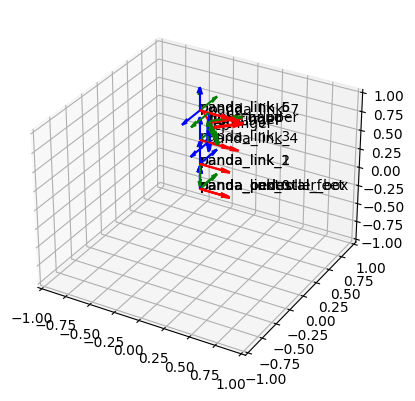
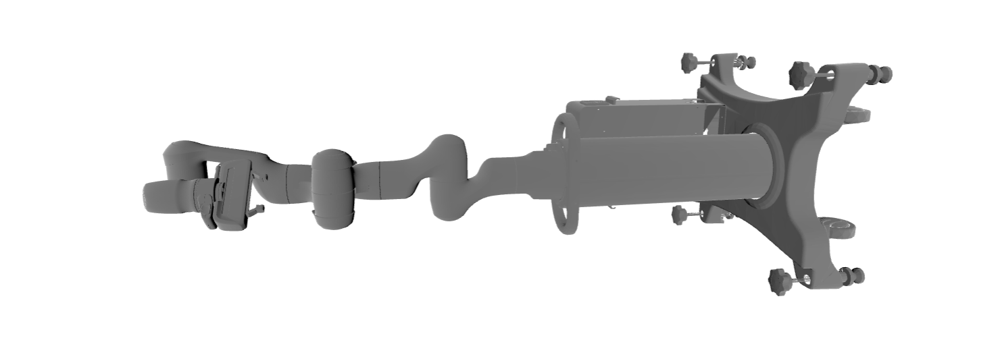

Link Positions:
Link: panda_link_0, Position: [0. 0. 0.]
   Link: panda_pedestal, Position: [0. 0. 0.]
   Link: panda_controller_box, Position: [0. 0. 0.]
   Link: panda_pedestal_feet, Position: [0. 0. 0.]
   Link: panda_link_1, Position: [0.    0.    0.333]
      Link: panda_link_2, Position: [0.    0.    0.333]
         Link: panda_link_3, Position: [ 0.00000000e+00 -1.54732208e-12  6.49000000e-01]
            Link: panda_link_4, Position: [ 8.25000000e-02 -1.54732208e-12  6.49000000e-01]
               Link: panda_link_5, Position: [0.00000000e+00 3.32968042e-13 1.03300000e+00]
                  Link: panda_link_6, Position: [0.00000000e+00 3.32968042e-13 1.03300000e+00]
                     Link: panda_link_7, Position: [8.80000000e-02 3.32968042e-13 1.03300000e+00]
                        Link: right_hand, Position: [ 8.80000000e-02 -7.10005385e-13  9.26500000e-01]
                           Link: right_gripper, Position: [ 8.80000000e-02 -7.10005385e-13  9.26500000e-01]
         

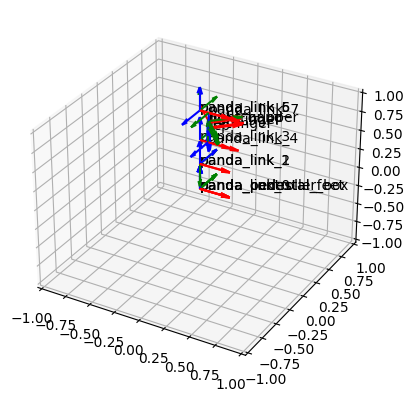

In [ ]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D, art3d
import numpy as np
import trimesh

def draw_frame(ax, T, name, scale=0.3):
    """
    Draw the X, Y, and Z axes of a frame based on the transformation matrix.
    """
    # Origin of the frame
    origin = T[:3, 3]

    # Directions of the X, Y, Z axes transformed by the rotation part of T
    x_dir = T[:3, :3] @ np.array([scale, 0, 0])
    y_dir = T[:3, :3] @ np.array([0, scale, 0])
    z_dir = T[:3, :3] @ np.array([0, 0, scale])

    # Draw the axes
    ax.quiver(*origin, *x_dir, color='r', length=scale, normalize=True)
    ax.quiver(*origin, *y_dir, color='g', length=scale, normalize=True)
    ax.quiver(*origin, *z_dir, color='b', length=scale, normalize=True)
    # Add the frame name as text
    ax.text(*origin, name, color='black')

def rpy_to_rotation_matrix(rpy):
    """
    Convert roll-pitch-yaw angles into a rotation matrix.

    Args:
        rpy (tuple/list/np.array): The roll, pitch, and yaw angles.

    Returns:
        np.array: The corresponding rotation matrix.
    """
    # Convert RPY to rotation matrix
    roll, pitch, yaw = rpy
    Rx = np.array([
        [1, 0, 0],
        [0, np.cos(roll), -np.sin(roll)],
        [0, np.sin(roll), np.cos(roll)]
    ])
    Ry = np.array([
        [np.cos(pitch), 0, np.sin(pitch)],
        [0, 1, 0],
        [-np.sin(pitch), 0, np.cos(pitch)]
    ])
    Rz = np.array([
        [np.cos(yaw), -np.sin(yaw), 0],
        [np.sin(yaw), np.cos(yaw), 0],
        [0, 0, 1]
    ])
    R = Rz @ Ry @ Rx
    return R

def compute_transformation(rpy, position):
    """
    Compute a homogeneous transformation matrix from RPY angles and position.

    Args:
        rpy (tuple/list/np.array): Roll, pitch, and yaw angles.
        position (tuple/list/np.array): The x, y, z position.

    Returns:
        np.array: The 4x4 homogeneous transformation matrix.
    """
    # Compute transformation matrix
    R = rpy_to_rotation_matrix(rpy)
    T = np.eye(4)
    T[:3, :3] = R
    T[:3, 3] = position
    return T

def initial_forward_kinematics(link, chain_transformation=np.eye(4)):
    """
    Recursively computes the forward kinematics for the robot, updating each link's
    transformation matrix relative to the base frame. This function traverses the robot's
    kinematic chain from the base link to the end-effectors.

    Args:
        link (Link): The current link object being processed. Initially, this should
                     be the root link of the robot.
        chain_transformation (np.array): The accumulated transformation matrix representing
                                         the position and orientation of the current link
                                         with respect to the base frame. Initially, this
                                         is an identity matrix for the base link.
    """
    # Update the transformation matrix of the current link.
    # This matrix transforms points from the link's local frame to the global frame.
    link.transformation = chain_transformation

    # Iterate through all child joints of the current link.
    for child_joint in link.children:
        # Calculate the transformation matrix from the current link to the child link.
        # This involves computing the rotation from RPY angles and translating along the joint's origin position. For movable joints, the joint's configuration (e.g., angle) would also influence this transformation.
        # Multiply the current chain transformation by the newly computed transformation to get the transformation matrix for the child link relative to the base frame.
        # Recursively apply the forward kinematics computation to the child link, passing along the updated transformation matrix.
        T_joint_to_child = compute_transformation(child_joint.origin_orientation, child_joint.origin_position)
        child_transformation = chain_transformation @ T_joint_to_child
        initial_forward_kinematics(child_joint.child_link, child_transformation)

def print_link_positions(link, level=0):
    """
    Recursively print the positions of each link in the robot structure.

    Args:
        link (Link): The current link.
        level (int): The current depth in the robot structure for indentation.
    """
    # Print the position of each link recursively
    indent = "   " * level
    position = link.transformation[:3, 3]
    print(f"{indent}Link: {link.name}, Position: {position}")
    for child_joint in link.children:
      print_link_positions(child_joint.child_link, level + 1)


def visualize_robot_frames_with_axes(root_link):
    """
    Visualize the frames of a robot with axes for each link.

    Args:
        root_link (Link): The root link of the robot structure.
    """
    # Setup plot and recursively draw each link's frame
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    def recurse_links(link):
      draw_frame(ax, link.transformation, link.name)
      for child_joint in link.children:
        recurse_links(child_joint.child_link)
    recurse_links(root_link)
    ax.set_xlim([-1, 1]), ax.set_ylim([-1, 1]), ax.set_zlim([-1, 1])

def visualize_robot_with_meshes(links):
    """
    Visualize the combined mesh of all links in the robot structure.

    Args:
        links (dict): A dictionary of links with their names as keys.
    """
    # Combine and visualize all link meshes
    combined_mesh = None
    for name, link in links.items():
      if link.visuals is not None:
        for visual in link.visuals:
          if visual.filename is not None:
            filename = visual.filename
            T_link_to_mesh = compute_transformation(visual.origin_orientation, visual.origin_position)
            mesh = trimesh.load_mesh(filename)
            mesh.apply_transform(link.transformation @ T_link_to_mesh)
            if combined_mesh is None:
              combined_mesh = mesh
            else:
              combined_mesh += mesh
    display(combined_mesh.show())


# Load the robot structure from the URDF file (see previous step)
prefix = './urdf/urdf/panda/'
urdf_path = 'panda.urdf'
root_link, links, joints = parse_urdf(urdf_path,prefix=prefix)

# Compute forward kinematics with an example joint angle
initial_forward_kinematics(root_link)

# Print the positions of each link
print("Link Positions:")
print_link_positions(root_link)
visualize_robot_frames_with_axes(root_link)
visualize_robot_with_meshes(links)

###Repeat for other urdf files

Link Positions:
Link: sawyer_base, Position: [0. 0. 0.]
   Link: sawyer_controller_box, Position: [0. 0. 0.]
   Link: sawyer_pedestal_feet, Position: [0. 0. 0.]
   Link: sawyer_pedestal, Position: [0. 0. 0.]
   Link: sawyer_right_arm_base_link, Position: [0. 0. 0.]
      Link: sawyer_link_0, Position: [0.   0.   0.08]
         Link: sawyer_head, Position: [0.     0.     0.3765]
            Link: sawyer_screen, Position: [0.03   0.     0.4815]
            Link: sawyer_head_camera, Position: [0.0228027 0.        0.593072 ]
         Link: sawyer_right_torso_itb, Position: [-0.055  0.     0.3  ]
         Link: sawyer_link_1, Position: [0.081 0.05  0.317]
            Link: sawyer_link_2, Position: [0.221  0.1925 0.317 ]
               Link: sawyer_link_3, Position: [0.481  0.1505 0.317 ]
                  Link: sawyer_link_4, Position: [0.606 0.024 0.317]
                     Link: sawyer_right_arm_itb, Position: [0.681 0.024 0.372]
                     Link: sawyer_link_5, Position: [0.881

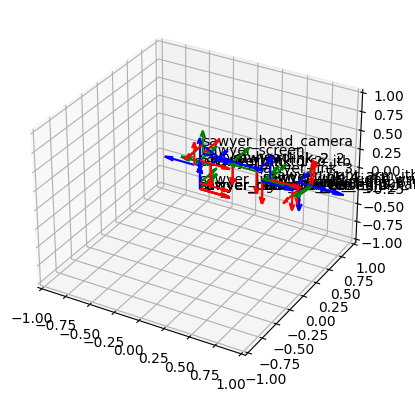

In [ ]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D, art3d
import numpy as np
import trimesh

def draw_frame(ax, T, name, scale=0.3):
    """
    Draw the X, Y, and Z axes of a frame based on the transformation matrix.
    """
    # Origin of the frame
    origin = T[:3, 3]

    # Directions of the X, Y, Z axes transformed by the rotation part of T
    x_dir = T[:3, :3] @ np.array([scale, 0, 0])
    y_dir = T[:3, :3] @ np.array([0, scale, 0])
    z_dir = T[:3, :3] @ np.array([0, 0, scale])

    # Draw the axes
    ax.quiver(*origin, *x_dir, color='r', length=scale, normalize=True)
    ax.quiver(*origin, *y_dir, color='g', length=scale, normalize=True)
    ax.quiver(*origin, *z_dir, color='b', length=scale, normalize=True)
    # Add the frame name as text
    ax.text(*origin, name, color='black')

def rpy_to_rotation_matrix(rpy):
    """
    Convert roll-pitch-yaw angles into a rotation matrix.

    Args:
        rpy (tuple/list/np.array): The roll, pitch, and yaw angles.

    Returns:
        np.array: The corresponding rotation matrix.
    """
    # Convert RPY to rotation matrix
    roll, pitch, yaw = rpy
    Rx = np.array([
        [1, 0, 0],
        [0, np.cos(roll), -np.sin(roll)],
        [0, np.sin(roll), np.cos(roll)]
    ])
    Ry = np.array([
        [np.cos(pitch), 0, np.sin(pitch)],
        [0, 1, 0],
        [-np.sin(pitch), 0, np.cos(pitch)]
    ])
    Rz = np.array([
        [np.cos(yaw), -np.sin(yaw), 0],
        [np.sin(yaw), np.cos(yaw), 0],
        [0, 0, 1]
    ])
    R = Rz @ Ry @ Rx
    return R

def compute_transformation(rpy, position):
    """
    Compute a homogeneous transformation matrix from RPY angles and position.

    Args:
        rpy (tuple/list/np.array): Roll, pitch, and yaw angles.
        position (tuple/list/np.array): The x, y, z position.

    Returns:
        np.array: The 4x4 homogeneous transformation matrix.
    """
    # Compute transformation matrix
    R = rpy_to_rotation_matrix(rpy)
    T = np.eye(4)
    T[:3, :3] = R
    T[:3, 3] = position
    return T

def initial_forward_kinematics(link, chain_transformation=np.eye(4)):
    """
    Recursively computes the forward kinematics for the robot, updating each link's
    transformation matrix relative to the base frame. This function traverses the robot's
    kinematic chain from the base link to the end-effectors.

    Args:
        link (Link): The current link object being processed. Initially, this should
                     be the root link of the robot.
        chain_transformation (np.array): The accumulated transformation matrix representing
                                         the position and orientation of the current link
                                         with respect to the base frame. Initially, this
                                         is an identity matrix for the base link.
    """
    # Update the transformation matrix of the current link.
    # This matrix transforms points from the link's local frame to the global frame.
    link.transformation = chain_transformation

    # Iterate through all child joints of the current link.
    for child_joint in link.children:
        # Calculate the transformation matrix from the current link to the child link.
        # This involves computing the rotation from RPY angles and translating along the joint's origin position. For movable joints, the joint's configuration (e.g., angle) would also influence this transformation.
        # Multiply the current chain transformation by the newly computed transformation to get the transformation matrix for the child link relative to the base frame.
        # Recursively apply the forward kinematics computation to the child link, passing along the updated transformation matrix.
        T_joint_to_child = compute_transformation(child_joint.origin_orientation, child_joint.origin_position)
        child_transformation = chain_transformation @ T_joint_to_child
        initial_forward_kinematics(child_joint.child_link, child_transformation)

def print_link_positions(link, level=0):
    """
    Recursively print the positions of each link in the robot structure.

    Args:
        link (Link): The current link.
        level (int): The current depth in the robot structure for indentation.
    """
    # Print the position of each link recursively
    indent = "   " * level
    position = link.transformation[:3, 3]
    print(f"{indent}Link: {link.name}, Position: {position}")
    for child_joint in link.children:
      print_link_positions(child_joint.child_link, level + 1)


def visualize_robot_frames_with_axes(root_link):
    """
    Visualize the frames of a robot with axes for each link.

    Args:
        root_link (Link): The root link of the robot structure.
    """
    # Setup plot and recursively draw each link's frame
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    def recurse_links(link):
      draw_frame(ax, link.transformation, link.name)
      for child_joint in link.children:
        recurse_links(child_joint.child_link)
    recurse_links(root_link)
    ax.set_xlim([-1, 1]), ax.set_ylim([-1, 1]), ax.set_zlim([-1, 1])

def visualize_robot_with_meshes(links):
    """
    Visualize the combined mesh of all links in the robot structure.

    Args:
        links (dict): A dictionary of links with their names as keys.
    """
    # Combine and visualize all link meshes
    combined_mesh = None
    for name, link in links.items():
      if link.visuals is not None:
        for visual in link.visuals:
          if visual.filename is not None:
            filename = visual.filename
            T_link_to_mesh = compute_transformation(visual.origin_orientation, visual.origin_position)
            mesh = trimesh.load_mesh(filename)
            mesh.apply_transform(link.transformation @ T_link_to_mesh)
            if combined_mesh is None:
              combined_mesh = mesh
            else:
              combined_mesh += mesh
    display(combined_mesh.show())


# Load the robot structure from the URDF file (see previous step)
prefix = './urdf/urdf/sawyer/'
urdf_path = 'sawyer.urdf'
root_link, links, joints = parse_urdf(urdf_path,prefix=prefix)

# Compute forward kinematics with an example joint angle
initial_forward_kinematics(root_link)

# Print the positions of each link
print("Link Positions:")
print_link_positions(root_link)
visualize_robot_frames_with_axes(root_link)
visualize_robot_with_meshes(links)